In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import numpy as np
import pandas as pd
import tensorflow
from zipfile import ZipFile
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from sklearn.metrics import accuracy_score

**1. Load the dataset and create the metadata.**

In [ ]:
project_path = '/content/drive/MyDrive/ACV Project 2 Dataset/'

In [ ]:
images_zip_path = project_path + "Dataset Aligned Face Dataset from Pinterest.zip"

from zipfile import ZipFile

with ZipFile(images_zip_path, 'r') as z:
  z.extractall()

In [ ]:
lst   = os.listdir('/content/pins/PINS')
print(lst)

['pins_Betsy Brandt', 'pins_Willa Holland', 'pins_lindsey morgan face', 'pins_miguel herran', 'pins_kiernan shipka ', 'pins_Pedro Alonso', 'pins_margot robbie face', 'pins_Natalie Portman ', 'pins_shakira', 'pins_Robin Taylor', 'pins_gal gadot face', 'pins_Josh Radnor', 'pins_Anna Gunn', 'pins_eliza taylor', 'pins_Tom Cavanagh', 'pins_grant gustin face', 'pins_Morgan Freeman', 'pins_Krysten Ritter', 'pins_Cameron Monaghan', 'pins_brie larson', 'pins_Emilia Clarke', 'pins_chadwick boseman face', 'pins_Neil Patrick Harris', 'pins_Gwyneth Paltrow', 'pins_mark zuckerberg', 'pins_Ursula Corbero', 'pins_jeff bezos', 'pins_Chris Pratt', 'pins_dua lipa face', 'pins_drake', 'pins_Cobie Smulders', 'pins_maria pedraza', 'pins_Melissa benoit', 'pins_Sebastian Stan', 'pins_Rami Melek', 'pins_tom holland face', 'pins_Brenton Thwaites', 'pins_Dwayne Johnson', 'pins_alexandra daddario', 'pins_jason isaacs', 'pins_William Fichtner', 'pins_Ryan Reynolds', 'pins_Thomas Middleditch', 'pins_elon musk', 'pi

In [ ]:
people=[]
for foldername in lst:
  people.append(foldername)


In [ ]:
len(people)

100

In [ ]:
source_dir='/content/pins/PINS'

In [ ]:
class IdentityMetadata():
    def __init__(self, base, name, file):
        # print(base, name, file)
        # dataset base directory
        self.base = base
        # identity name
        self.name = name
        # image file name
        self.file = file

    def __repr__(self):
        return self.image_path()

    def image_path(self):
        return os.path.join(self.base, self.name, self.file) 

In [ ]:
def load_metadata(path):
    metadata = []
    for i in os.listdir(path):
        for f in os.listdir(os.path.join(path, i)):
            
            ext = os.path.splitext(f)[1]
            if ext == '.jpg' or ext == '.jpeg':
                metadata.append(IdentityMetadata(path, i, f))
    return np.array(metadata)


In [ ]:
metadata = load_metadata('PINS')

In [ ]:
import cv2
def load_image(path):
    img = cv2.imread(path, 1)
    return img[...,::-1]

**Check some samples of metadata.**




In [ ]:
n = np.random.randint(1, len(metadata))
img_path = metadata[n].image_path()
img = load_image(img_path)
labels = np.array([meta.name for meta in metadata])

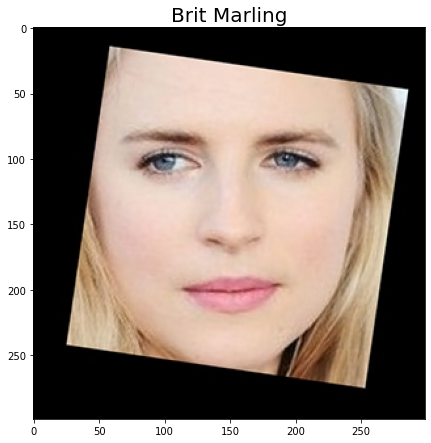

In [ ]:

fig = plt.figure(figsize = (15, 7.2))
ax = fig.add_subplot(1, 1, 1)
title = labels[n].split('_')[1]
ax.set_title(title, fontsize = 20)
_ = plt.imshow(img)

**Load the pre-trained model and weights.**

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import ZeroPadding2D, Convolution2D, MaxPooling2D, Dropout, Flatten, Activation

def vgg_face():	
    model = Sequential()
    model.add(ZeroPadding2D((1,1),input_shape=(224,224, 3)))
    model.add(Convolution2D(64, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(128, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(256, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(ZeroPadding2D((1,1)))
    model.add(Convolution2D(512, (3, 3), activation='relu'))
    model.add(MaxPooling2D((2,2), strides=(2,2)))
    
    model.add(Convolution2D(4096, (7, 7), activation='relu'))
    model.add(Dropout(0.5))
    model.add(Convolution2D(4096, (1, 1), activation='relu'))
    model.add(Dropout(0.5))
    model.add(Convolution2D(2622, (1, 1)))
    model.add(Flatten())
    model.add(Activation('softmax'))
    return model





In [ ]:
model = vgg_face()
model.load_weights('/content/drive/MyDrive/VGG_weights/vgg_face_weights.h5')
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
zero_padding2d (ZeroPadding2 (None, 226, 226, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 224, 224, 64)      1792      
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 226, 226, 64)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 64)      36928     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 112, 112, 64)      0         
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 114, 114, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 112, 112, 128)     7

In [ ]:

from tensorflow.keras.models import Model
vgg_face_descriptor = Model(inputs=model.layers[0].input, outputs=model.layers[-2].output)

**Generate Embedding vectors for each face in the dataset.**

In [ ]:

# Get embedding vector for first image in the metadata using the pre-trained model

img_path = metadata[0].image_path()
img = load_image(img_path)

# Normalising pixel values from [0-255] to [0-1]: scale RGB values to interval [0,1]
img = (img / 255.).astype(np.float32)

img = cv2.resize(img, dsize = (224,224))
print(img.shape)

# Obtaining embedding vector for an image
# Get the embedding vector for the above image using vgg_face_descriptor model and print the shape 

embedding_vector = vgg_face_descriptor.predict(np.expand_dims(img, axis=0))[0]
print(embedding_vector.shape)

(224, 224, 3)
(2622,)


In [ ]:
embeddings = []
embeddings = np.zeros((metadata.shape[0], 2622))
for i, meta in tqdm(enumerate(metadata)):
  try:
    image = load_image(str(meta))
    image = (image/255.).astype(np.float32)
    image = cv2.resize(image, (224, 224))
    embeddings[i] = vgg_face_descriptor.predict(np.expand_dims(image, axis = 0))[0]
  except:
    embeddings[i] = np.zeros(2622)

**Build distance metrics for identifying the distance between two given images**

In [ ]:
def distance(emb1, emb2):
    return np.sum(np.square(emb1 - emb2))

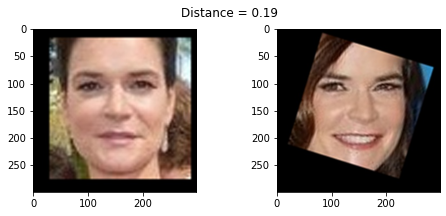

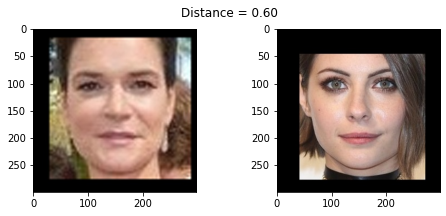

In [ ]:
import matplotlib.pyplot as plt

def show_pair(idx1, idx2):
    plt.figure(figsize=(8,3))
    plt.suptitle(f'Distance = {distance(embeddings[idx1], embeddings[idx2]):.2f}')
    plt.subplot(121)
    plt.imshow(load_image(metadata[idx1].image_path()))
    plt.subplot(122)
    plt.imshow(load_image(metadata[idx2].image_path()));    

show_pair(2, 3)
show_pair(2, 180)

In [ ]:
train_idx = np.arange(metadata.shape[0]) % 9 != 0     #every 9th example goes in test data and rest go in train data
test_idx = np.arange(metadata.shape[0]) % 9 == 0

# one half as train examples of 10 identities
X_train = embeddings[train_idx]
# another half as test examples of 10 identities


X_test = embeddings[test_idx]

targets = np.array([m.name for m in metadata])
#train labels
y_train = targets[train_idx]
#test labels

y_test = targets[test_idx]

In [ ]:
from sklearn.preprocessing import LabelEncoder


encoder = LabelEncoder()
y_train = encoder.fit_transform(y_train)
y_test = encoder.transform(y_test)

In [ ]:
# Standarize features
from sklearn.preprocessing import StandardScaler


sc = StandardScaler()
X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.transform(X_test)

**Use PCA for dimensionality reduction.**

In [ ]:
from sklearn.decomposition import PCA


pca = PCA(n_components = 128)
pca.fit(X_train_sc)
X_train_pca = pca.transform(X_train_sc)
X_test_pca = pca.transform(X_test_sc)
display(X_train_pca.shape, X_test_pca.shape)

(9573, 128)

(1197, 128)

**Build an SVM classifier to map each image to its right person.**

In [ ]:
from sklearn.svm import SVC

random_state=83
svc_pca = SVC(C = 1, gamma = 0.001, kernel = 'rbf', class_weight = 'balanced', random_state = random_state)
svc_pca.fit(X_train_pca, y_train)
print('SVC accuracy for train set: {0:.3f}'.format(svc_pca.score(X_train_pca, y_train)))

SVC accuracy for train set: 0.999


In [ ]:

# Predict
y_pred = svc_pca.predict(X_test_pca)

# Accuracy Score
print('Accuracy Score: {}'.format(accuracy_score(y_test, y_pred).round(3)))

Accuracy Score: 0.942


In [ ]:
p = cv2.resize(load_image(metadata[test_idx][10].image_path()), (224, 224)).shape

In [ ]:
sample_img = load_image(metadata[test_idx][10].image_path())
sample_img = (sample_img/255.).astype(np.float32)
# Resize
sample_img = cv2.resize(sample_img, (224, 224))

# Obtain embedding vector for sample image
embedding = vgg_face_descriptor.predict(np.expand_dims(sample_img, axis = 0))[0]
# Scaled the vector and reshape
embedding_scaled = sc.transform(embedding.reshape(1, -1))
# Predict
sample_pred = svc_pca.predict(pca.transform(embedding_scaled))
pred_name = encoder.inverse_transform(sample_pred)[0]

In [ ]:
sample_pred

array([61])

In [ ]:
encoder.inverse_transform(sample_pred)[0]

'pins_Willa Holland'

**Predict using the SVM model.**

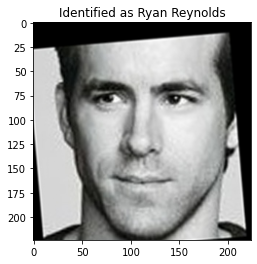

In [ ]:
import warnings
# Suppress LabelEncoder warning
warnings.filterwarnings('ignore')

example_idx = 500

example_image = load_image(metadata[test_idx][example_idx].image_path())

# example_prediction

example_image = (example_image/255.).astype(np.float32)
# Resize
example_image = cv2.resize(example_image, (224, 224))

# Obtain embedding vector for sample image
embedding = vgg_face_descriptor.predict(np.expand_dims(example_image, axis = 0))[0]
# Scaled the vector and reshape
embedding_scaled = sc.transform(embedding.reshape(1, -1))
# Predict
example_prediction = svc_pca.predict(pca.transform(embedding_scaled))

example_identity = encoder.inverse_transform(example_prediction)[0].split('_')[-1].title().strip()

plt.imshow(example_image)
plt.title(f'Identified as {example_identity}');

**Part TWO**

In [3]:
from google.colab.patches import cv2_imshow

In [59]:
import time
import numpy as np
import cv2
# Create our body classifier
car_classifier = cv2.CascadeClassifier('/content/haarcascade_car.xml')
# Initiate video capture for video file
cap = cv2.VideoCapture('/content/drive/MyDrive/ACV Project 2 Dataset/video1.mp4')
# Loop once video is successfully loaded
save_path='/content/Video/predicted_video.mp4'

    
# Read first frame
ret, frame = cap.read()
img_h=frame.shape[0]
img_w=frame.shape[1]
if save_path:
  _fourcc=cv2.VideoWriter_fourcc(*'VP90')
  _out=cv2.VideoWriter(save_path,_fourcc,25,(img_w,img_h))
  while ret:
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    # Pass frame to our car classifier
    cars = car_classifier.detectMultiScale(gray, 1.1, 2)
    # Extract bounding boxes for any bodies identified
    for (x,y,w,h) in cars:
      frame=cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 255), 2)
        #cv2_imshow=cv2
        #cv2_imshow(frame)
        #cv2.imwrite(f'/content/framesofvideo/{i}.jpg', frame)
        #i=i+1
    if save_path:
      _out.write(frame)
    ret, frame = cap.read()
cap.release()

if save_path:
  _out.release()



In [63]:
path='/content/drive/MyDrive/ACV Project 2 Dataset/video1.mp4'
mp4 = open(path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [62]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "/content/Video/predicted_video.mp4"

# Compressed video path
compressed_path = "/content/Video/predicted_videocompressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)